<h1 style="font-family:Times New Roman; font-size: 300%"><center>Advanced Machine Learning For Physics </center></h1>


<h2 style="font-family:Times New Roman; font-weight:bolder; font-size:240%">Hamiltonian Neural Networks with Dissipative forces</h2>

<p style="font-family:Times New Roman; font-size:120%">
    The following notebook is my recreation of parts of the 2022 <a href = "https://arxiv.org/pdf/2201.10085v2">article    </a>, building further on Hamiltonian neural networks (HNN). 
</p>

<h2 style="font-family:Times New Roman; font-size:200%">Part I | The Motivation |</h2>

<p style="font-family:Times New Roman; font-size:120%">
    The basic form of HNN's analyzied worked well, but only for the most simple physical systems, where Energy or some other quantity is exactly conserved. The model started to struggle immediately once some friction was introduced. This is of course not suprising, considering that the system is designed to keep it constant. It does beg the question though, what if it is not? In this notebook, we will implement the proposed solution by the article mentioned above.  
</p>

<h3 style="font-family:Times New Roman; font-size:150%">Dissipative Mechanics</h3>


<p style="font-family:Times New Roman; font-size:120%">
    Any system, can be decomposed to a conservative part and a non-conservative part, for a vector-field, Helmholtz-decomposition helps with this. The Dissipative part of the systems we will look at, 
</p>

In [1]:
import Pkg; Pkg.activate(".julia/environments/v1.10/Project.toml")
Pkg.add("Optimisers")
using Flux, Plots, Zygote, Optimisers,Statistics, Random, NBInclude
import Distributions: Uniform
Pkg.add("BSON");using BSON: @save, @load

  Activating project at `~/.julia/environments/v1.10`
    Updating registry at `~/.julia/registries/General.toml`
   Resolving package versions...
  No Changes to `~/.julia/environments/v1.10/Project.toml`
  No Changes to `~/.julia/environments/v1.10/Manifest.toml`
   Resolving package versions...
  No Changes to `~/.julia/environments/v1.10/Project.toml`
  No Changes to `~/.julia/environments/v1.10/Manifest.toml`


In [2]:
@nbinclude("Utilities.ipynb")

meshgrid

In [3]:
?train_model

search: train_model



```
train_model(model, loss, x_data, y_data, x_test, y_test; epochs=2000, lr=0.001, batch=false, batch_size=30)
```

Train a machine learning model using the specified loss function and data.

# Arguments

  * `model`: The model to be trained.
  * `loss`: The loss function to be minimized.
  * `x_data`: Training input data.
  * `y_data`: Training output data.
  * `x_test`: Test input data for evaluation.
  * `y_test`: Test output data for evaluation.

# Keyword Arguments

  * `epochs=2000`: The number of training epochs.
  * `lr=0.001`: The learning rate.
  * `batch=false`: Whether to use batch training.
  * `batch_size=30`: The size of the batches for batch training.

# Returns

  * `model`: The trained model.


In [4]:
#=
#?train_model
#?generate_data
#?RK4_step
#?Energy
#?meshgrid
=#

In [185]:
function fetch_models(input_dim, hidden_dim)
    dhnn_H = Flux.Chain(
        Flux.Dense(input_dim, hidden_dim, tanh),
        Flux.Dense(hidden_dim, hidden_dim, tanh),
        Flux.Dense(hidden_dim, 1, tanh)
    )
    dhnn_D = Flux.Chain(
        Flux.Dense(input_dim, hidden_dim, tanh),
        Flux.Dense(hidden_dim, hidden_dim, tanh),
        Flux.Dense(hidden_dim, 1, tanh)
    )
    hnn = Flux.Chain(
        Flux.Dense(input_dim, hidden_dim, tanh),
        Flux.Dense(hidden_dim, hidden_dim, tanh),
        Flux.Dense(hidden_dim, 1, tanh)
    )
    baseline = Flux.Chain(
        Flux.Dense(input_dim, hidden_dim, tanh),
        Flux.Dense(hidden_dim, hidden_dim, tanh),
        Flux.Dense(hidden_dim, 2, tanh)
    )

    return dhnn_H, dhnn_D, hnn, baseline
end

function train_dhnn(dhnn_H, dhnn_D, x_train, y_train, x_test, y_test; batch=30,epochs=2000)
    lr=0.001
    opt_H=Flux.setup(Optimisers.Adam(lr), dhnn_H)
    opt_D=Flux.setup(Optimisers.Adam(lr), dhnn_D)

    batch_size=batch
    batches =round(length(x_train[1,:])/batch_size)
    for epoch in 1:epochs

        for i in 1:batches-1
            a, b = Int(batch_size*(i-1)+1), Int(batch_size*(i)+1)
            input = view(x_train, :, a:b)
            label = view(y_train, :, a:b)

            Grads_H = Flux.gradient(m -> lossDH(m, dhnn_D , input, label), dhnn_H)
            Grads_D = Flux.gradient(m -> lossDH(dhnn_H, m , input, label), dhnn_D)
            
            Flux.update!(opt_H, dhnn_H, Grads_H[1])
            Flux.update!(opt_D, dhnn_D, Grads_D[1])
        end
        a = Int(batch_size*(batches-1)+1)
        input = view(x_train, :, a:length(x_train[1,:,1]))
        label = view(y_train, :, a:length(y_train[1,:,1]))
        Grads_H = Flux.gradient(m -> lossDH(m, dhnn_D , input, label), dhnn_H)
        Grads_D = Flux.gradient(m -> lossDH(dhnn_H, m , input, label), dhnn_D)

        Flux.update!(opt_H, dhnn_H, Grads_H[1])
        Flux.update!(opt_D, dhnn_D, Grads_D[1])
        
        if (epoch-1)%100==0
            loss_test=lossDH(dhnn_H, dhnn_D, x_test, y_test)
            println("Epoch=$epoch :loss = $loss_test")
        end

    end
    return dhnn_H, dhnn_D
end
function dhnn_simD(model, input;rho=1) #Dissipative part of D-HNNN
    pred = gradient(sum ∘ model,input)[1]
    return pred.*rho
end

function dhnn_simH(model, input) #Hamiltonian part of D-HNN
    H = gradient(sum ∘ model,input)[1]
    n = size(H, 1) ÷ 2
    pred=vcat(selectdim(H, 1, (n + 1):(2n)), -selectdim(H, 1, 1:n))
    return pred
end

dhnn_sim(models, input;rho=1) = dhnn_simH(models[1], input) .+ dhnn_simD(models[2], input; rho)

function project(v,n)
    # Reshape v into vx and vy assuming v is 2x400 and needs to be 20x20
    vx = reshape(v[1, :], n, n)
    vy = reshape(v[2, :], n, n)
    
    p = zeros(size(vx))
    div =  -0.5 * (circshift(vx, (0,-1)) - circshift(vx, (0,1)) + circshift(vy, (-1,0)) - circshift(vy, (1,0)))

    for k in 1:1000# use gauss-seidel to approximately solve linear system
        p = (div + circshift(p, (0, 1)) + circshift(p, (0,-1)) + circshift(p, (1,0)) + circshift(p, (-1,0)))/4.0
    end

    vx =   vx .- 0.5*(circshift(p, (0,-1)) - circshift(p, (0,1)))
    vy =   vy .- 0.5*(circshift(p, (-1,0)) - circshift(p, (0,1)))

    return vx, vy
            
end
function approx_helmholtz_decomp(x, dx) # assumes x, dx have axes (batch, coords)
    n=Int(sqrt(length(x[1,:])))
    dx_rot1,dx_rot2 = project(dx,n) #np.stack(project(dx1, dx2), axis=-1)
    dx_rot=permutedims(cat(dx_rot1,dx_rot2,dims=3), (3,1,2))
    dx_rot = reshape(dx_rot,2,n^2)
    dx_irr = dx .- dx_rot # Helmholtz-Hodge decomposition identity
    return x, dx, dx_rot, dx_irr
end

approx_helmholtz_decomp (generic function with 1 method)

<h2 style="font-family:Times New Roman; font-size:200%">Part II | Mass-spring with friction |</h2>

<p style="font-family:Times New Roman; font-size:120%">
    Perhaps the most simple dynamical physical system one can think of. And fittingly, the first example in their paper, as well as my own code here. It is governed by a simple differential equation.
</p>

$$
m\ddot x = -kx \longrightarrow \begin{cases}
    \frac{dx}{dt}= v \\
    m\frac{dv}{dt}=-kx-\rho v
  \end{cases}
$$
    
<p style="font-family:Times New Roman; font-size:120%">
    As we will in all the systems here, we have split the second order ODE into two first order ODE's, and as the original paper did, we will assume that $k=m=1, \rho$ will be altered, but first set to 0.5. 
</p>

In [196]:
function sampler_spring(n_sims)
    r = rand(Uniform(0.4,1.5), n_sims)
    phi = rand(Uniform(0,2*pi),n_sims)
    x= @. r * cos(phi)
    y= @. r * sin(phi)

    return vcat(x', y')
end

function grads_d(data)
    x = data[1,:]
    y = data[2,:]
    return permutedims(hcat(y, -x-0.5* y)) #rho=0.5
end
function grads_spring(data;rho=0)::Matrix{Float64}
    x = data[1,:]
    y = data[2,:]
    return permutedims(hcat(y, -x - rho*y)) #rho=0.5
end
function grads_f(data)
    x = data[1,:]
    y = data[2,:]
    return permutedims(hcat(y, -x))
end

grads_f (generic function with 1 method)

2×320 Matrix{Float64}:
 -1.5      -1.5      -1.5       -1.5       …  1.5       1.5      1.5      1.5
 -1.34211  -1.02632  -0.710526  -0.552632     0.710526  1.02632  1.18421  1.5

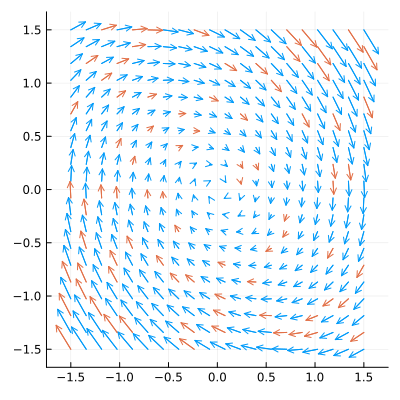

In [187]:
x_train, x_test = meshgrid(20, train=true)
display(x_train)
y_train = grads_spring(x_train;rho=0.5)
y_test = grads_spring(x_test;rho=0.5)

quiver(x_train[1, :],x_train[2, :],quiver=(y_train[1, :].*0.1, y_train[2, :].*0.1), size=(400,400), label="train data")
quiver!(x_test[1, :],x_test[2, :],quiver=(y_test[1, :].*0.1, y_test[2, :].*0.1), label="test data")

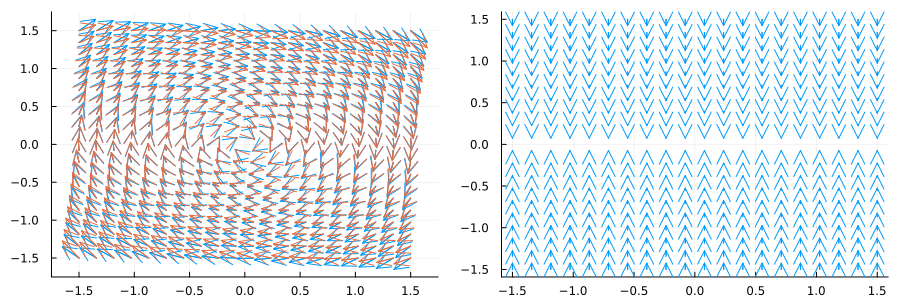

In [188]:

Grid = meshgrid(20,train=false)
v_f = grads_spring(Grid;rho=0) .*0.1 #.*0.1 because it plots nicer!
v_d = grads_spring(Grid;rho=0.5) .*0.1
v_fd = v_d.-v_f #.*0.1
p = quiver(Grid[1, :],Grid[2, :],quiver=(v_f[1, :], v_f[2, :]), layout=(1,2), size=(900,300))
quiver!(p,Grid[1, :],Grid[2, :],quiver=(v_d[1, :], v_d[2, :]), subplot=1)
quiver!(p,Grid[1, :],Grid[2, :],quiver=(v_fd[1, :], v_fd[2, :]),subplot=2)
display(p)


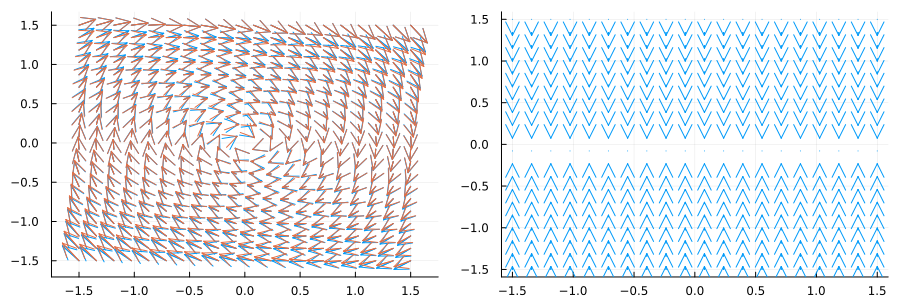

In [189]:
x, dx, dx_rot, dx_irr=approx_helmholtz_decomp(Grid, v_d)
dx_tot = dx_rot .+ dx_irr
p=quiver(Grid[1, :],Grid[2, :],quiver=(dx_rot[1, :], dx_rot[2, :]),layout=(1,2),size=(900,300))
quiver!(p,Grid[1, :],Grid[2, :],quiver=(dx_irr[1, :], dx_irr[2, :]),subplot=2)
quiver!(p,Grid[1, :],Grid[2, :],quiver=(dx_tot[1, :], dx_tot[2, :]),subplot=1)

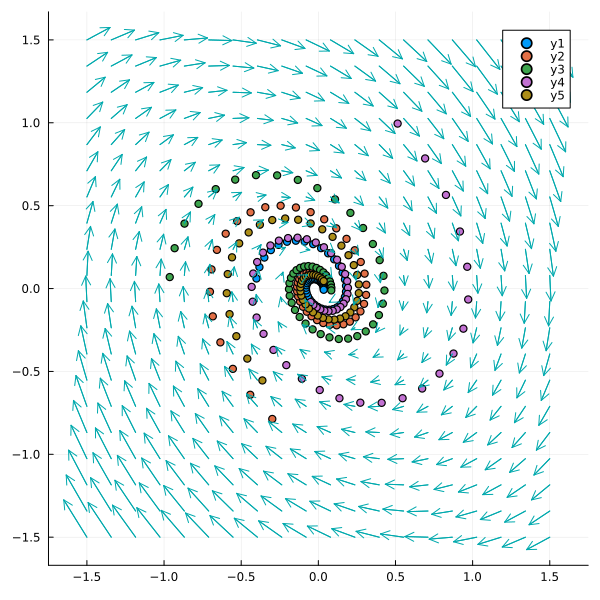

In [190]:
t, x, y = generate_data(grads_d,5, 50, 10.; sampler=sampler_spring)
scatter(x[1,:,1], x[2,:,1])
for i in 2:5
    scatter!(x[1,:,i], x[2,:,i])
end
quiver!(Grid[1, :],Grid[2, :],quiver=(v_d[1, :], v_d[2, :]), size=(600,600))

In [191]:
#dual_model(model1,model2,x) = model1(x),model2(x)
function lossHNN(mod, input, label)
    #temp=gradient(sum ∘ mod,input)[1]
    H = gradient(sum ∘ mod,input)[1]
    n = size(H, 1) ÷ 2
    pred=vcat(selectdim(H, 1, (n + 1):(2n)), -selectdim(H, 1, 1:n))
    return mean(abs2, pred .- label)
end
function loss_b(m,x, y) #Baseline loss
    y_hat = m(x)
    y_hat_x,y_hat_v = y_hat
    y_x, y_v = y
    return 1/length(y)*( sum((y_hat_x-y_x).^2+(y_hat_v-y_v).^2))
end
function lossDH(model1, model2, input, label)
    #temp=gradient(sum ∘ mod,input)[1]
    H = gradient(sum ∘ model1,input)[1]
    D = gradient(sum ∘ model2,input)[1]
    n = size(H, 1) ÷ 2
    pred=vcat(selectdim(H, 1, (n + 1):(2n)), -selectdim(H, 1, 1:n))
    return mean(abs2, pred .+ D .- label)
end



lossDH (generic function with 1 method)

In [192]:
dhnn_H, dhnn_D, hnn, baseline = fetch_models(2, 256)
dhnn_H, dhnn_D = train_dhnn(dhnn_H, dhnn_D, x_train, y_train, x_test, y_test, batch=30)
hnn = train_model(hnn, lossHNN, x_train, y_train, x_test, y_test, batch=true)
baseline = train_model(baseline, loss_b, x_train, y_train, x_test, y_test, batch=true)

Epoch=1 :loss = 1.087108227368303
Epoch=101 :loss = 0.34537226876607885
Epoch=201 :loss = 0.12395022129379399
Epoch=301 :loss = 0.09234801131067467
Epoch=401 :loss = 0.02480894452696438
Epoch=501 :loss = 0.014135840517291711
Epoch=601 :loss = 0.007301472249442287
Epoch=701 :loss = 0.08053338839399862
Epoch=801 :loss = 0.06085380739600359
Epoch=901 :loss = 0.009005567630424784
Epoch=1001 :loss = 0.002995583320661607
Epoch=1101 :loss = 0.01333113447991106
Epoch=1201 :loss = 0.01680791552511338
Epoch=1301 :loss = 0.013153836174396008
Epoch=1401 :loss = 0.0034414363231723352
Epoch=1501 :loss = 0.0021210082743923467
Epoch=1601 :loss = 0.00526962436683831
Epoch=1701 :loss = 0.0019210256479899046
Epoch=1801 :loss = 0.0029778911971381646
Epoch=1901 :loss = 0.07794920225390999
Epoch=100 :loss = 0.5985096522412325
Epoch=200 :loss = 0.17092749474738797
Epoch=300 :loss = 0.16294808452140153
Epoch=400 :loss = 0.16087986501667315
Epoch=500 :loss = 0.15915764444071087
Epoch=600 :loss = 0.154678940895

Chain(
  Dense(2 => 256, tanh),                # 768 parameters
  Dense(256 => 256, tanh),              # 65_792 parameters
  Dense(256 => 2, tanh),                # 514 parameters
)                   # Total: 6 arrays, 67_074 parameters, 262.383 KiB.

In [193]:
t, x, y = generate_data(grads_d,1, 50, 10.; sampler=sampler_spring)
t, x_est_hnn, y_est_hnn = generate_data(dhnn_simH,1, 50, 10.; model=hnn, inits=x[:,1])
t, x_est_b, y_est_b = generate_data(baseline, 1, 50, 10.; inits=x[:,1])
t, x_est, y_est = generate_data(dhnn_sim,1, 50, 10.; model=(dhnn_H, dhnn_D), inits=x[:,1])

dhnn_D_est = dhnn_simD(dhnn_D, Grid)
dhnn_H_est = dhnn_simH(dhnn_H, Grid)
hnn_H_est = dhnn_simH(hnn, Grid)
baseline_est = baseline(Grid)

2×400 Matrix{Float32}:
 -0.999984  -0.999973  -0.999951  …   0.99972    0.999853   0.999918
  0.999913   0.999902   0.999888     -0.999873  -0.999891  -0.999904

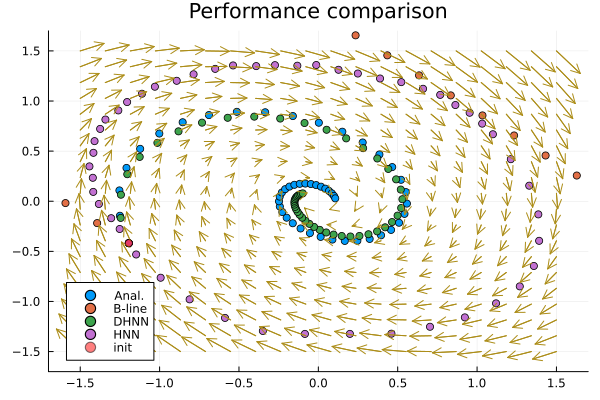

In [194]:
scatter(x[1,:], x[2,:], label="Anal.", ylimits=(-1.7, 1.7), xlimits=(-1.7, 1.7), title="Performance comparison")
scatter!( x_est_b[1,:], x_est_b[2,:], label="B-line")
scatter!( x_est[1,:], x_est[2,:], label="DHNN")
scatter!(x_est_hnn[1,:], x_est_hnn[2,:], label="HNN")
quiver!(Grid[1, :],Grid[2, :],quiver=(v_d[1, :], v_d[2, :]))
scatter!([x[1,1]], [x[2,1]], label="init", color=:red, alpha=0.5)

In [195]:


quiver(Grid[1, :],Grid[2, :],quiver=(dhnn_D_est[1, :].*0.1, dhnn_D_est[2, :].*0.1), layout=4, size=(1000, 1000))
quiver!(Grid[1, :],Grid[2, :],quiver=(v_fd[1, :], v_fd[2, :]), alpha=0.3, subplot=1, title="DHNN-Diss..")

quiver!( Grid[1, :],Grid[2, :], quiver=((dhnn_D_est[1, :].+dhnn_H_est[1, :]).*0.1, (dhnn_D_est[2, :].+dhnn_H_est[2, :]).*0.1), subplot=2)
quiver!( Grid[1, :],Grid[2, :], quiver=(dx_tot[1, :], dx_tot[2, :]), subplot=2, alpha=0.3, title="DHNN.")

quiver!( Grid[1, :],Grid[2, :], quiver=(baseline_est[1, :].*0.1, baseline_est[2, :].*0.1), subplot=3)
quiver!( Grid[1, :],Grid[2, :], quiver=(dx_tot[1, :], dx_tot[2, :]), subplot=3, alpha=0.3, title="B-line")

quiver!( Grid[1, :],Grid[2, :], quiver=(hnn_H_est[1, :].*0.1, hnn_H_est[2, :].*0.1), subplot=4)
quiver!( Grid[1, :],Grid[2, :], quiver=(dx_tot[1, :], dx_tot[2, :]), subplot=4, alpha=0.3, title="HNN")

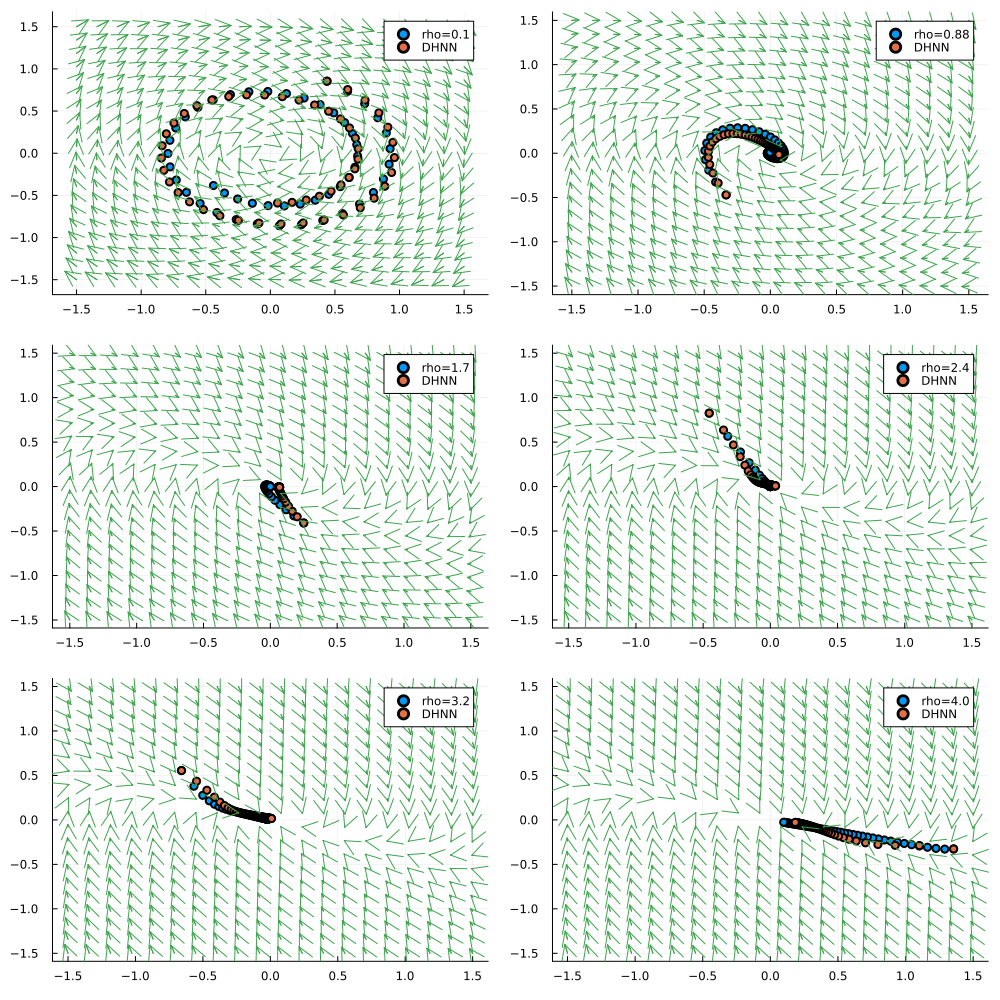

In [197]:

rhoVals = LinRange(0.1, 4, 6)
p = plot(layout=(3,2), size=(1000, 1000))
for (i,Rho) in enumerate(rhoVals)
    v_d = grads_spring(Grid; rho=Rho) 
    v_d ./= maximum(v_d)*10
    x, dx, dx_rot, dx_irr=approx_helmholtz_decomp(Grid, v_d)
    dx_tot = dx_rot .+ dx_irr

    t, x, y = generate_data(grads_spring,1, 50, 10.; sampler=sampler_spring, rho=Rho)
    #trained rho is 0.5, therefore for any rho we must multiply by 2
    t, x_est, y_est = generate_data(dhnn_sim,1, 50, 10.; model=(dhnn_H, dhnn_D), inits=x[:,1], rho=Rho*2)
    r=round(Rho, sigdigits=2)
    scatter!(p,x[1,:], x[2,:], label="rho=$r",subplot=i)
    scatter!(p, x_est[1,:], x_est[2,:], label="DHNN", subplot=i)
    quiver!(p,Grid[1, :],Grid[2, :],quiver=(v_d[1, :], v_d[2, :]), subplot=i)
    
end
display(p)

<h2 style="font-family:Times New Roman; font-size: 300%"><center>Ideal Pendulum</center></h2>


In [17]:
using DelimitedFiles

Data = readdlm("/Users/aleksandersekkelsten/Downloads/invar_datasets/real_pend_h_1.txt")
x_vals = vcat(Data[2:end,3]',Data[2:end,4]')
dts = Data[2:end,2][2:end].- Data[2:end,2][1:end-1]
dxs = zeros(size(x_vals[:,1:end-1]))
    
for i in 1:2
    dxs[i,:] = x_vals[i,2:end] .- x_vals[i,1:end-1] ./dts
end
x_vals = Matrix{Float64}(x_vals)
t = Array{Float64}(Data[2:end-1,2])
dxs = Matrix{Float64}(dxs)
data = Dict("x" => x_vals[:,1:end-1], "dx" => dxs, "t" => t)

Dict{String, Array{Float64}} with 3 entries:
  "t"  => [5.0, 5.16667, 5.33333, 5.5, 5.66667, 6.0, 6.16667, 6.33333, 6.5, 6.6…
  "x"  => [1.13839 1.27536 … 0.805003 0.775497; 0.91978 0.71938 … -0.0574959 -0…
  "dx" => [-5.55498 -6.26243 … -4.05452 -3.91705; -4.7993 -3.81633 … 0.137279 0…

In [18]:
test_split=0.8
b = Int(length(data["x"][1,:]) * test_split)
Keys = keys(data)
Values = values(data)
split = Dict()
for (i, key) in enumerate(Keys)
    vals = data[key]

    if key!="t"
        split[key] = vals[:,1:b]#hcat(vals[:,1:a], vals[:,b:end])
        split["test_"*key] = vals[:,b:end]
    else
        split[key] = vals[1:b]#vcat(vals[1:a], vals[b:end])
        split["test_"*key] = vals[b:end]
    end
    
end
split
data=split

# Function to compute velocities using numerical differentiation
function compute_velocities(positions::Vector{Float64}, times::Vector{Float64})::Vector{Float64}
    n = length(positions)
    velocities = zeros(Float64, n)

    # Forward difference for the first element
    velocities[1] = (positions[2] - positions[1]) / (times[2] - times[1])
    
    # Central difference for the interior points
    for i in 2:n-1
        velocities[i] = (positions[i+1] - positions[i-1]) / (times[i+1] - times[i-1])
    end
    
    # Backward difference for the last element
    velocities[n] = (positions[n] - positions[n-1]) / (times[n] - times[n-1])

    return velocities
end

velocities = compute_velocities(data["x"][1,:], data["t"])
data["dx"][1,:] .= velocities
velocities = compute_velocities(data["x"][2,:], data["t"])
data["dx"][2,:] .= velocities
velocities = compute_velocities(data["test_x"][1,:], data["t"])
data["test_dx"][1,:] .= velocities
velocities = compute_velocities(data["test_x"][2,:], data["t"])
data["test_dx"][2,:] .= velocities


112-element view(::Matrix{Float64}, 2, :) with eltype Float64:
 -0.2156285871258557
 -0.34967441292109347
 -0.5376731772423402
 -0.6408178305025334
 -0.498927248890638
 -0.5407751843332278
 -0.8836941804571418
 -0.9822123418982907
 -1.0075079700654168
 -0.995840885228362
 -0.9505706711788031
 -0.8486449996996781
 -0.7550152655172304
  ⋮
  0.1728676744749708
  0.032406406943832004
 -0.1328160304724926
 -0.3768565679808673
 -0.5349785585483351
 -0.6346507753322777
 -0.7628596487686137
 -0.5495280294112774
 -0.5767017479018648
 -0.881963543796382
 -0.8854873223515685
 -0.9012018010445629

In [19]:
x_train = data["x"]
y_train = data["dx"]#grads_ideal_pend(data["x"])#data["dx"]

x_test = data["test_x"]
y_test = data["test_dx"]#grads_ideal_pend(data["test_x"])#data["test_dx"]
x_train

function grads_ideal_pend(y)
    q = y[1,:]
    p = y[2,:]
    # d^2q/dt^2 = -g/L sin(q)
    # -> dp/dt = -3*sin(q), dq/dt=p
    dq_dt=p
    dp_dt = @. -2.4*sin(q)
    return permutedims(hcat(dq_dt, dp_dt))
end

grads_ideal_pend (generic function with 1 method)

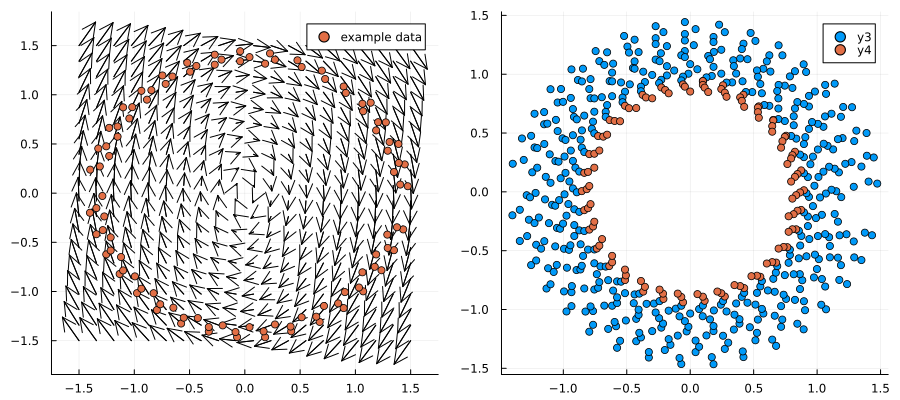

In [20]:
pend_field = grads_ideal_pend(Grid)#vectorfield2d(grads_ideal_pend, fieldd)

quiver(Grid[1, :],Grid[2, :],quiver=(pend_field[1, :].*0.1, pend_field[2, :].*0.1), layout=(1,2),size=(900,400), label="train data",c=:black)
scatter!(x_train[1,1:100], x_train[2,1:100], label="example data",subplot=1)
scatter!(x_train[1,:], x_train[2,:],subplot=2)
scatter!(x_test[1,:], x_test[2,:], subplot=2)

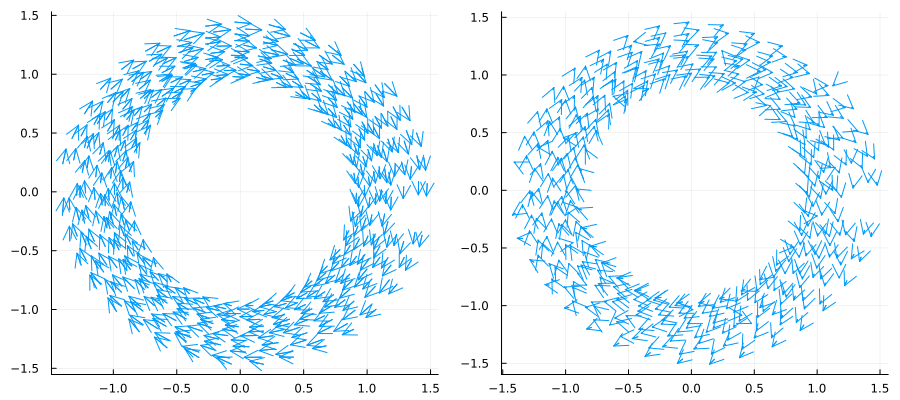

In [21]:
x, dx, dx_rot, dx_irr=approx_helmholtz_decomp(data["x"][:,1:441], data["dx"][:,1:441])
p=quiver(x[1, :],x[2, :],quiver=(dx_rot[1, :].*0.1, dx_rot[2, :]*0.1),layout=(1,2),size=(900,400))
quiver!(p,x[1, :],x[2, :],quiver=(dx_irr[1, :]*0.1, dx_irr[2, :]*0.1),subplot=2)

In [22]:
dhnn_H, dhnn_D, hnn, baseline = fetch_models(2, 256)
dhnn_H, dhnn_D = train_dhnn(dhnn_H, dhnn_D, x_train, y_train, x_test, y_test, batch=30)
hnn = train_model(hnn, lossHNN, x_train, y_train, x_test, y_test, batch=true)
baseline = train_model(baseline, loss_b, x_train, y_train, x_test, y_test, batch=true)

Epoch=1 :loss = 0.32215544185951844
Epoch=101 :loss = 0.011704350619822527
Epoch=201 :loss = 0.009273374475827456
Epoch=301 :loss = 0.008740666633491661
Epoch=401 :loss = 0.010331546302225924
Epoch=501 :loss = 0.010038549416349605
Epoch=601 :loss = 0.010617160988890244
Epoch=701 :loss = 0.008456827572675196
Epoch=801 :loss = 0.007570532483565595
Epoch=901 :loss = 0.008409922752951368
Epoch=1001 :loss = 0.00713576346944029
Epoch=1101 :loss = 0.007679414283464533
Epoch=1201 :loss = 0.007129492050911352
Epoch=1301 :loss = 0.0070493635596131435
Epoch=1401 :loss = 0.007238026918938203
Epoch=1501 :loss = 0.0076169476606260805
Epoch=1601 :loss = 0.007359711437223565
Epoch=1701 :loss = 0.00791559956175507
Epoch=1801 :loss = 0.00831264297519205
Epoch=1901 :loss = 0.006865172608565323
Epoch=100 :loss = 0.008017367106860502
Epoch=200 :loss = 0.009733583343412523
Epoch=300 :loss = 0.0070001646314350316
Epoch=400 :loss = 0.007807938018098044
Epoch=500 :loss = 0.009438131367429606
Epoch=600 :loss = 

Chain(
  Dense(2 => 256, tanh),                # 768 parameters
  Dense(256 => 256, tanh),              # 65_792 parameters
  Dense(256 => 2, tanh),                # 514 parameters
)                   # Total: 6 arrays, 67_074 parameters, 262.383 KiB.

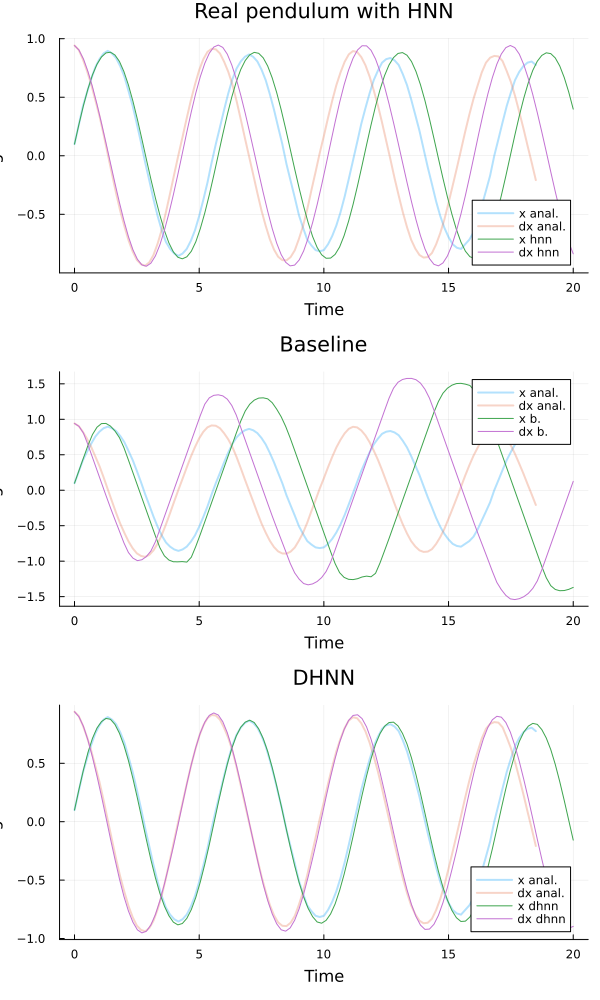

In [23]:
t_ar=data["test_t"] .-minimum(data["test_t"])
n_steps = length(t_ar)
t_end = t_ar[end]
anal = data["test_x"]

t, est_hnn, _ = generate_data(dhnn_simH, 1, length(anal[1,:]), 20., model = hnn, inits=anal[:,1])
t, est_baseline, _ = generate_data(baseline, 1, length(anal[1,:]), 20., inits=anal[:,1])
t, x_est, y_est = generate_data(dhnn_sim,1, length(anal[1,:]), 20.; model=(dhnn_H, dhnn_D), inits=anal[:,1])

gr()
p = plot(t_ar, anal[1,:], linewidth = 2, title = "Real pendulum with HNN",
    xaxis = "Time", yaxis = "Elongation", label = "x anal.", layout=(3,1), size=(600, 1000),alpha=.3)
plot!(p,t_ar, anal[2,:], linewidth = 2,
    xaxis = "Time", yaxis = "Elongation", label = "dx anal.", subplot=1,alpha=.3)
plot!(p,t_ar, anal[1,:], linewidth = 2, label = "x anal.", subplot=2,title = "Baseline",alpha=.3)
plot!(p,t_ar, anal[2,:], linewidth = 2, label = "dx anal.", subplot=2,alpha=.3)

plot!(p,t_ar, anal[1,:], linewidth = 2, label = "x anal.", subplot=3,title = "DHNN",alpha=.3)
plot!(p,t_ar, anal[2,:], linewidth = 2, label = "dx anal.", subplot=3,alpha=.3)


plot!(p,t, est_baseline[1,:], label="x b.", subplot=2)
plot!(p,t, est_baseline[2,:], label="dx b.", subplot=2)
plot!(p,t, est_hnn[1,:], label="x hnn", subplot=1)
plot!(p,t, est_hnn[2,:], label="dx hnn",  subplot=1)

plot!(p,t, x_est[1,:], label="x dhnn", subplot=3)
plot!(p,t, x_est[2,:], label="dx dhnn",  subplot=3)

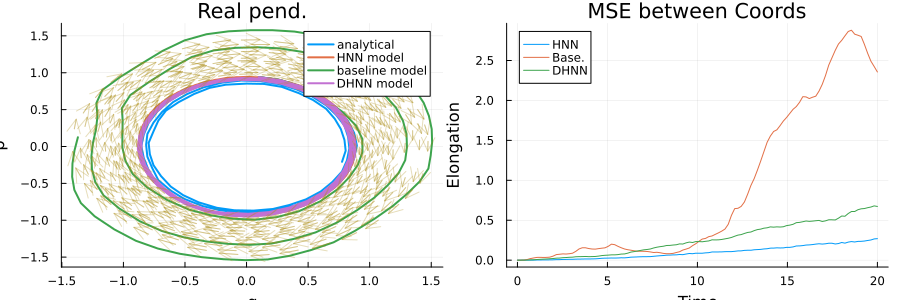

In [24]:
function MSE(true_x, base_x)
    return vec(mean((true_x .- base_x).^2, dims=1))  # Use dims=1 to compute mean along columns
end

            
mse_hnn = MSE(est_hnn, anal)
mse_base = MSE(est_baseline, anal)
mse_dhnn = MSE(x_est, anal)


p = plot(anal[1,:], anal[2,:], linewidth = 2, title = "Simple Harmonic Oscillator",
    xaxis = "Time", yaxis = "Elongation", label = "analytical", layout=(1,2), size=(900, 300))
plot!(p,est_hnn[1,:], est_hnn[2,:], linewidth = 2, title = "Simple Harmonic Oscillator",
    xaxis = "q", yaxis = "p", label = "HNN model", subplot=1)
plot!(p,est_baseline[1,:], est_baseline[2,:], linewidth = 2, title = "Real pend.",
    xaxis = "q", yaxis = "p", label = "baseline model", subplot=1)
plot!(p,x_est[1,:], x_est[2,:], linewidth = 2, title = "Real pend.",
    xaxis = "q", yaxis = "p", label = "DHNN model", subplot=1)

plot!(p,t, mse_hnn, label="HNN", title = "MSE between Coords", subplot=2)
plot!(p,t, mse_base, label="Base.", subplot=2)
plot!(p,t, mse_dhnn, label="DHNN", subplot=2)

quiver!(p,x[1, :],x[2, :],quiver=((dx_rot[1, :].+dx_irr[1, :]).*0.1, (dx_rot[2, :].+dx_irr[2, :])*0.1),layout=(1,2),subplot=1, alpha=0.3)

In [8]:

function simulate_path(N, vector_field, pos_field, initial_position, dt, num_steps)
    # Initialize the position array
    positions = zeros(Float64, 2, num_steps + 1)
    positions[:, 1] = initial_position
    
    for step in 1:num_steps
        # Get the current position
        x = positions[:, step]
        
        # Ensure the position is within bounds
        i = findmin(sum(abs.(pos_field .-x),dims=1))[2][2]

        # Get the vector from the vector field
        vx = vector_field[1, i]
        vy = vector_field[2, i]
        
        # Update the position using Euler's method
        positions[1, step + 1] = x[1] + vx * dt
        positions[2, step + 1] = x[2] + vy * dt
        
        # Ensure the new position stays within the grid
        #positions[:, step + 1] .= clamp.(positions[:, step + 1], 1, N)
    end
    
    return positions
end


simulate_path (generic function with 1 method)

In [9]:
function generate_chaotic_vector_field(N, num_vortices)
    # Initialize the 2xN^2 array
    vector_field = zeros(Float64, 2, N^2)
    
    # Parameters for the structured part
    amplitude = 10.0
    perturbation_strength = 0.3  # Controlled perturbation strength

    # Define vortex centers and strengths
    centers = [(rand(1:N), rand(1:N)) for _ in 1:num_vortices]
    strengths = [rand([-3, 3]) * amplitude for _ in 1:num_vortices]
    
    for i in 1:N
        for j in 1:N
            # Calculate the indices in the 1D array representation
            index = (i-1) * N + j
            
            # Initialize the field components
            vx, vy = 0.0, 0.0
            
            for k in 1:num_vortices
                center_x, center_y = centers[k]
                strength = strengths[k]
                
                # Calculate the radial and angular components
                dx = i - center_x
                dy = j - center_y
                r = sqrt(dx^2 + dy^2) + 1e-6  # Add a small value to avoid division by zero
                
                # Angular component (creating circular motion around the center)
                angular_x = -dy / r
                angular_y = dx / r
                
                # Combine angular components with controlled perturbations
                vx += strength * angular_x + randn() * perturbation_strength
                vy += strength * angular_y + randn() * perturbation_strength
            end
            
            # Normalize the vector sum to avoid extremely large values
            norm_factor = sqrt(vx^2 + vy^2) + 1e-6
            vector_field[1, index] = vx / norm_factor
            vector_field[2, index] = vy / norm_factor
        end
    end
    
    return vector_field
end

generate_chaotic_vector_field (generic function with 1 method)

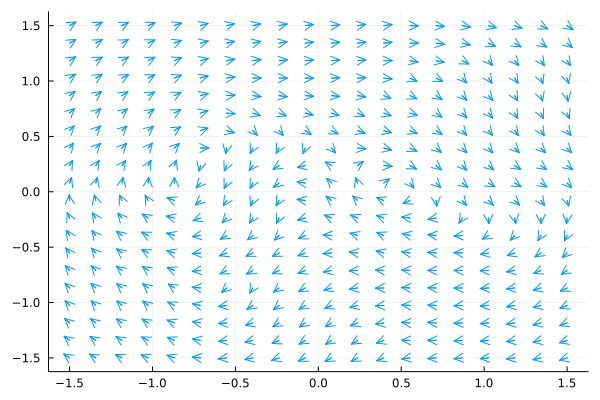

In [31]:
# Example usage
N = 20
Grid=meshgrid(N)
num_orbits = 80  # Number of smaller circular orbits
vector_field = generate_chaotic_vector_field(N, num_orbits).*0.5

p=quiver(Grid[1,:],Grid[2,:], quiver=(vector_field[1,:].*0.1,vector_field[2,:].*0.1))

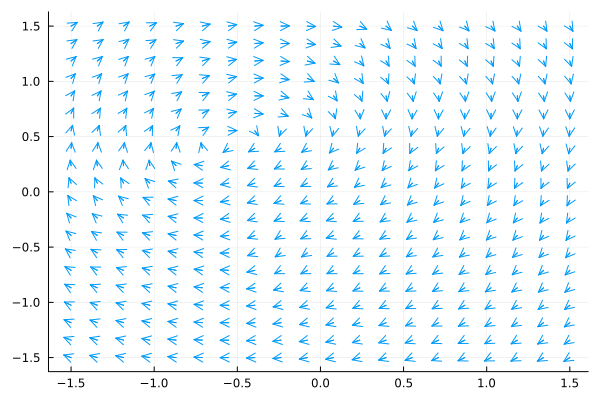

In [11]:
display(p)

In [23]:
# Example usage
N = 20
num_orbits = 8  # Number of smaller circular orbits
vector_field = generate_chaotic_vector_field(N, num_orbits).*0.5
Grid=meshgrid(N)
initial_position = [-0.5, 0]
dt = 0.1
num_steps = 300
positions = simulate_path(100, vector_field, Grid, initial_position, dt, num_steps)
# Plot the path


2×301 Matrix{Float64}:
 -0.5  -0.498114   -0.495766   -0.493418  …   1.12757   1.17654   1.22551
  0.0  -0.0499644  -0.0999093  -0.149854     -1.56196  -1.55187  -1.54178

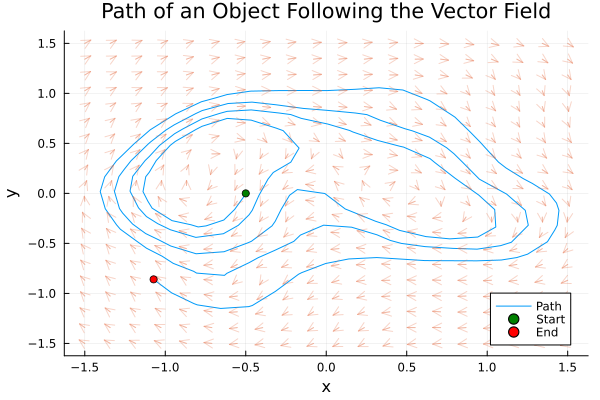

In [34]:

initial_position = [-0.5, 0]
dt = 0.05
num_steps = 1000
positions = simulate_path(100, vector_field, Grid, initial_position, dt, num_steps)

plot(positions[1, :], positions[2, :], label="Path", xlabel="x", ylabel="y", title="Path of an Object Following the Vector Field")
quiver!(Grid[1,:],Grid[2,:], quiver=(vector_field[1,:].*0.1,vector_field[2,:].*0.1), alpha=0.3)
scatter!([positions[1, 1]],[positions[2, 1]], label="Start", color=:green)
scatter!([positions[1, end]], [positions[2, end]], label="End", color=:red)


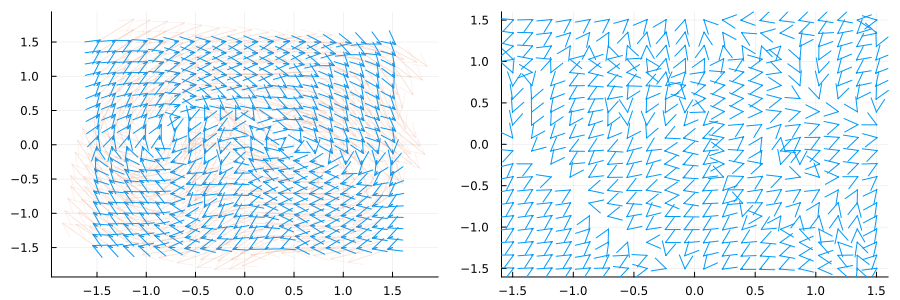

In [35]:
x, dx, dx_rot, dx_irr=approx_helmholtz_decomp(Grid, vector_field)
dx_tot = dx_rot .+ dx_irr
p=quiver(Grid[1, :],Grid[2, :],quiver=(dx_rot[1, :].*0.1, dx_rot[2, :].*0.1),layout=(1,2),size=(900,300))
quiver!(p,Grid[1, :],Grid[2, :],quiver=(dx_irr[1, :].*0.1, dx_irr[2, :].*0.1),subplot=2)
quiver!(p,Grid[1, :],Grid[2, :],quiver=(dx_tot[1, :], dx_tot[2, :]),subplot=1,alpha=0.1)
display(p)

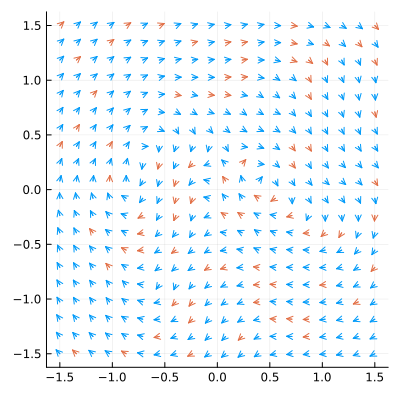

In [36]:
num_samples=size(vector_field)[2]
# Shuffle the indices
indices = shuffle(1:num_samples)
test_size=0.2
# Calculate the number of test samples
num_test_samples = round(Int, test_size * num_samples)

# Split the indices into train and test
test_indices = indices[1:num_test_samples]
train_indices = indices[num_test_samples+1:end]
x_train=Grid[:,train_indices]
y_train=vector_field[:,train_indices]
x_test=Grid[:,test_indices]
y_test=vector_field[:,test_indices]

quiver(x_train[1, :],x_train[2, :],quiver=(y_train[1, :].*0.1, y_train[2, :].*0.1), size=(400,400), label="train data")
quiver!(x_test[1, :],x_test[2, :],quiver=(y_test[1, :].*0.1, y_test[2, :].*0.1), label="test data")

In [41]:
dhnn_H, dhnn_D, hnn, baseline = fetch_models(2, 256)
dhnn_H, dhnn_D = train_dhnn(dhnn_H, dhnn_D, x_train, y_train, x_test, y_test, batch=30)
hnn = train_model(hnn, lossHNN, x_train, y_train, x_test, y_test, batch=true)
baseline = train_model(baseline, loss_b, x_train, y_train, x_test, y_test, batch=true)

Epoch=100 :loss = 0.009825912507081425
Epoch=200 :loss = 0.010131840514824023
Epoch=300 :loss = 0.008157973919978061
Epoch=400 :loss = 0.008022110110669167
Epoch=500 :loss = 0.008170318601281234
Epoch=600 :loss = 0.007651390932118135
Epoch=700 :loss = 0.0069816963879620235
Epoch=800 :loss = 0.00652306012049024
Epoch=900 :loss = 0.006135785993139041
Epoch=1000 :loss = 0.006251951566059823
Epoch=1100 :loss = 0.005974394619264393
Epoch=1200 :loss = 0.00594539903902208
Epoch=1300 :loss = 0.006051654435257882
Epoch=1400 :loss = 0.006115425595785015
Epoch=1500 :loss = 0.006517193155768805
Epoch=1600 :loss = 0.00676354356220787
Epoch=1700 :loss = 0.00700450582038039
Epoch=1800 :loss = 0.0073640445403558965
Epoch=1900 :loss = 0.007656833288785592
Epoch=2000 :loss = 0.007964377220426918
Epoch=100 :loss = 0.001754387881602781
Epoch=200 :loss = 0.0024593816753955863
Epoch=300 :loss = 0.0021994777613380994
Epoch=400 :loss = 0.0017848670397632633
Epoch=500 :loss = 0.0018298577061348774
Epoch=600 :l

Chain(
  Dense(2 => 256, tanh),                # 768 parameters
  Dense(256 => 256, tanh),              # 65_792 parameters
  Dense(256 => 2, tanh),                # 514 parameters
)                   # Total: 6 arrays, 67_074 parameters, 262.383 KiB.

In [42]:
DHNN_field = dhnn_sim((dhnn_H, dhnn_D), Grid)
HNN_field = dhnn_simH(dhnn_H, Grid)
baseline_field = baseline(Grid)

2×400 Matrix{Float32}:
 -0.208071  -0.215466  -0.234122  …   0.0920186   0.0795039   0.0720678
  0.488843   0.488262   0.470831     -0.5116     -0.508042   -0.501066

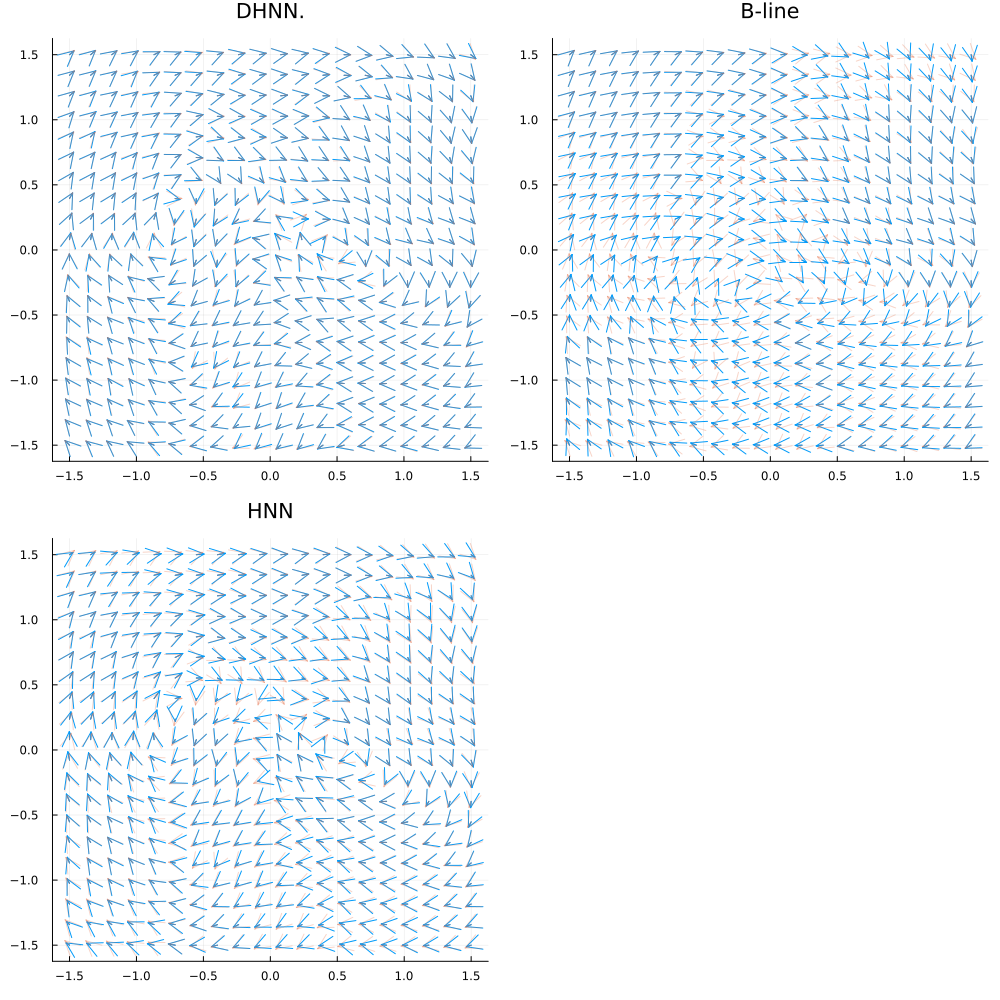

In [43]:
quiver(Grid[1, :],Grid[2, :], quiver=(DHNN_field[1, :].*0.1, DHNN_field[2,:].*0.1), layout=3, size=(1000,1000))
quiver!(Grid[1, :],Grid[2, :], quiver=(vector_field[1, :].*0.1, vector_field[2, :].*0.1),subplot=1 , alpha=0.3, title="DHNN.")

quiver!(Grid[1, :],Grid[2, :], quiver=(baseline_field[1, :].*0.1, baseline_field[2, :].*0.1), subplot=2)
quiver!(Grid[1, :],Grid[2, :], quiver=(vector_field[1, :].*0.1, vector_field[2, :].*0.1), subplot=2, alpha=0.3, title="B-line")

quiver!(Grid[1, :],Grid[2, :], quiver=(HNN_field[1, :].*0.1, HNN_field[2, :].*0.1), subplot=3)
quiver!(Grid[1, :],Grid[2, :], quiver=(vector_field[1, :].*0.1, vector_field[2, :].*0.1), subplot=3, alpha=0.3, title="HNN")

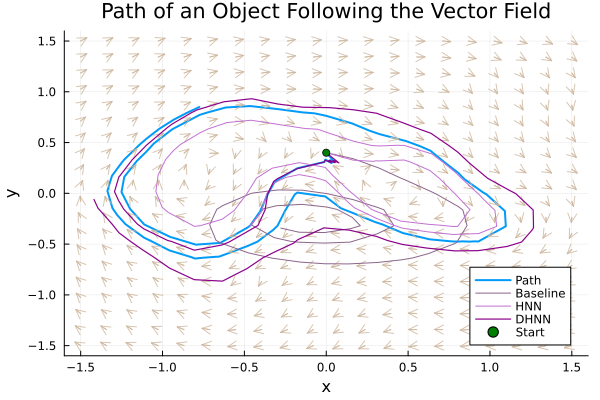

In [184]:
initial_position = [0,0.4]
dt = 0.05
num_steps = 400
positions = simulate_path(100, vector_field, Grid, initial_position, dt, num_steps)
pb = simulate_path(100, baseline_field, Grid, initial_position, dt, num_steps)
pHNN = simulate_path(100, HNN_field, Grid, initial_position, dt, num_steps)
pDHNN = simulate_path(100, DHNN_field, Grid, initial_position, dt, num_steps)

p=plot(positions[1, :], positions[2, :], linewidth=2,label="Path", xlabel="x", ylabel="y", title="Path of an Object Following the Vector Field",ylims=(-1.6,1.6),xlims=(-1.6,1.6),legend=true)
quiver!(p,Grid[1,:],Grid[2,:], quiver=(vector_field[1,:].*0.1,vector_field[2,:].*0.1),alpha=0.8, color=:bisque3)
plot!(p,pb[1, :], pb[2, :], label="Baseline",color=:plum4)
plot!(p,pHNN[1, :], pHNN[2, :], label="HNN")
plot!(p,pDHNN[1, :], pDHNN[2, :], label="DHNN",linewidth=1.2,color=:darkmagenta)

scatter!(p,[pb[1, 1]],[pb[2, 1]], label="Start", color=:green)
#scatter!([pb[1, end]], [pb[2, end]], label="End", color=:red)

In [82]:
display(p)

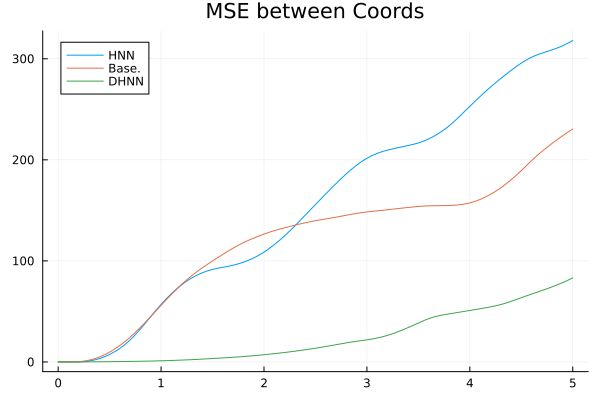

In [161]:
function MSE(true_x, base_x)
    return vec(mean((true_x .- base_x).^2, dims=1))  # Use dims=1 to compute mean along columns
end
t = LinRange(0,5,num_steps+1)       
mse_hnn = MSE(pHNN, positions)
mse_base = MSE(pb, positions)
mse_dhnn = MSE(pDHNN, positions)



plot(t, cumsum(mse_hnn), label="HNN", title = "MSE between Coords",legend=true)
plot!(t, cumsum(mse_base), label="Base.")
plot!(t, cumsum(mse_dhnn), label="DHNN")

#quiver!(grid[1, :],grid[2, :],quiver=(vector_field[1,:].*0.1, vector_field[2,:]*0.1), alpha=0.3)

In [38]:
using Plots; gr(legend=false)

# as: arrow head size 0-1 (fraction of arrow length)
# la: arrow alpha transparency 0-1
function arrow0!(p,x, y, u, v; as=0.07, lc=:black, la=1, alpha=1)
    nuv = sqrt(u^2 + v^2)
    v1, v2 = [u;v] / nuv,  [-v;u] / nuv
    v4 = (3*v1 + v2)/3.1623  # sqrt(10) to get unit vector
    v5 = v4 - 2*(v4'*v2)*v2
    v4, v5 = as*nuv*v4, as*nuv*v5
    plot!(p,[x,x+u], [y,y+v], lc=lc,la=la,size=(1000,1000),alpha=alpha)
    plot!(p,[x+u,x+u-v5[1]], [y+v,y+v-v5[2]], lc=lc, la=la,alpha=alpha)
    plot!(p,[x+u,x+u-v4[1]], [y+v,y+v-v4[2]], lc=lc, la=la,alpha=alpha)
end

arrow0! (generic function with 1 method)

In [39]:
#=
N = 100
num_orbits = 100  # Number of smaller circular orbits
vector_field = generate_chaotic_vector_field(N, num_orbits).*0.5
Grid=meshgrid(N)

num_samples=size(vector_field)[2]
# Shuffle the indices
indices = shuffle(1:num_samples)
test_size=0.2
# Calculate the number of test samples
num_test_samples = round(Int, test_size * num_samples)

# Split the indices into train and test
test_indices = indices[1:num_test_samples]
train_indices = indices[num_test_samples+1:end]
x_train=Grid[:,train_indices]
y_train=vector_field[:,train_indices]
x_test=Grid[:,test_indices]
y_test=vector_field[:,test_indices]
=#

N=100
Grid=meshgrid(N)

@load "vector_field.bson" vector_field

@load "x_train_field.bson" x_train
@load "y_train_field.bson" y_train

@load "x_test_field.bson" x_test
@load "y_test_field.bson" y_test

x, dx, dx_rot, dx_irr=approx_helmholtz_decomp(Grid, vector_field)
p=plot(xlims=(-2,2))
arrow0!(p,x_train[1,1],x_train[2,1], y_train[1,1].*0.1,y_train[2,1].*0.1, as=0.1, lc=:blue, la=1)
for i in 2:length(x_train[1,:])
    arrow0!(p,x_train[1,i],x_train[2,i], y_train[1,i].*0.1,y_train[2,i].*0.1, as=0.1, lc=:blue, la=1)
end
for i in 1:length(x_test[1,:])-1
    arrow0!(p,x_test[1,i],x_test[2,i], y_test[1,i].*0.1,y_test[2,i].*0.1, as=0.1, lc=:orange, la=1)
end
arrow0!(p,x_train[1,end],x_train[2,end], y_train[1,end].*0.1,y_train[2,end].*0.1, as=0.1, lc=:orange, la=1)

In [40]:
prot=plot(xlims=(-1.6,1.6),ylims=(-1.6,1.6))
for i in 1:length(Grid[1,:])
    arrow0!(prot,Grid[1,i],Grid[2,i], dx_rot[1,i].*0.1,dx_rot[2,i].*0.1, as=0.1, lc=:blue, la=1)
end

In [41]:
display(prot)

In [42]:
pirrot=plot(xlims=(-1.6,1.6),ylims=(-1.6,1.6))
for i in 1:length(Grid[1,:])
    arrow0!(pirrot,Grid[1,i],Grid[2,i], dx_irr[1,i].*0.1,dx_irr[2,i].*0.1, as=0.1, lc=:blue, la=1)
end

In [43]:
display(pirrot)

In [44]:
#=
dhnn_H, dhnn_D, hnn, baseline = fetch_models(2, 256)
dhnn_H, dhnn_D = train_dhnn(dhnn_H, dhnn_D, x_train, y_train, x_test, y_test, batch=100,epochs=2000)
hnn = train_model(hnn, losss, x_train, y_train, x_test, y_test, batch=true,batch_size=100,epochs=2000)
baseline = train_model(baseline, loss_b, x_train, y_train, x_test, y_test,batch_size=100, batch=true,epochs=2000)
Pkg.add("BSON");using BSON: @save
@save "DHNN_H_field.bson" dhnn_H
@save "DHNN_D_field.bson" dhnn_D
@save "baseline_field.bson" baseline
=#


Pkg.add("BSON")
using BSON: @load

@load "DHNN_H_field.bson" dhnn_H
@load "DHNN_D_field.bson" dhnn_D
@load "baseline_field.bson" baseline


   Resolving package versions...
  No Changes to `~/.julia/environments/v1.10/Project.toml`
  No Changes to `~/.julia/environments/v1.10/Manifest.toml`


In [45]:
DHNN_field = dhnn_sim((dhnn_H, dhnn_D), Grid)
HNN_field = dhnn_simH(dhnn_H, Grid)
baseline_field = baseline(Grid)

2×10000 Matrix{Float32}:
 -0.212188  -0.199596  -0.197274  …   0.531556   0.531709   0.531798
 -0.102607  -0.134205  -0.148136     -0.151418  -0.152808  -0.154137

In [46]:
pDHNN=plot(xlims=(-1.6,1.6),ylims=(-1.6,1.6))
for i in 1:length(Grid[1,:])
    arrow0!(pDHNN,Grid[1,i],Grid[2,i], DHNN_field[1,i].*0.1,DHNN_field[2,i].*0.1, as=0.1, lc=:blue, la=1)
end

In [47]:
pHNN=plot(xlims=(-1.6,1.6),ylims=(-1.6,1.6))
for i in 1:length(Grid[1,:])
    arrow0!(pHNN,Grid[1,i],Grid[2,i], HNN_field[1,i].*0.1,HNN_field[2,i].*0.1, as=0.1, lc=:blue, la=1)
end

In [48]:
pBase=plot(xlims=(-1.6,1.6),ylims=(-1.6,1.6))
for i in 1:length(Grid[1,:])
    arrow0!(pBase,Grid[1,i],Grid[2,i], baseline_field[1,i].*0.1,baseline_field[2,i].*0.1, as=0.1, lc=:blue, la=1)
end

In [49]:
display(pDHNN)

In [ ]:
display(pHNN)

In [ ]:
display(pBase)

In [ ]:
initial_position = [-0.25, 1.3]
dt = 0.07
num_steps = 50
positions = simulate_path(100, vector_field, Grid, initial_position, dt, num_steps)
pb = simulate_path(100, baseline_field, Grid, initial_position, dt, num_steps)
pHNN = simulate_path(100, HNN_field, Grid, initial_position, dt, num_steps)
pDHNN = simulate_path(100, DHNN_field, Grid, initial_position, dt, num_steps)

p=plot(positions[1, :], positions[2, :], linewidth=2,label="Path", xlabel="x", ylabel="y", title="Path of an Object Following the Vector Field",ylims=(-1.6,1.6),xlims=(-1.6,1.6),legend=false)
plot!(p,pb[1, :], pb[2, :], label="Baseline")
plot!(p,pHNN[1, :], pHNN[2, :], label="HNN")
plot!(p,pDHNN[1, :], pDHNN[2, :], label="DHNN")
for i in 1:length(Grid[1,:])
    arrow0!(p,Grid[1,i],Grid[2,i], vector_field[1,i].*0.1,vector_field[2,i].*0.1, as=0.1, lc=:blue, la=1,alpha=0.3)
end
scatter!(p,[pb[1, 1]],[pb[2, 1]], label="Start", color=:green)

In [ ]:
p

In [ ]:
initial_position = [-1.05, -1.2]
dt = 0.07
num_steps = 50
positions = simulate_path(100, vector_field, Grid, initial_position, dt, num_steps)
pb = simulate_path(100, baseline_field, Grid, initial_position, dt, num_steps)
pHNN = simulate_path(100, HNN_field, Grid, initial_position, dt, num_steps)
pDHNN = simulate_path(100, DHNN_field, Grid, initial_position, dt, num_steps)

p=plot(positions[1, :], positions[2, :], linewidth=2,label="Path", xlabel="x", ylabel="y", title="Path of an Object Following the Vector Field",ylims=(-1.6,1.6),xlims=(-1.6,1.6),legend=false)
plot!(p,pb[1, :], pb[2, :], label="Baseline")
plot!(p,pHNN[1, :], pHNN[2, :], label="HNN")
plot!(p,pDHNN[1, :], pDHNN[2, :], label="DHNN")
for i in 1:length(Grid[1,:])
    arrow0!(p,Grid[1,i],Grid[2,i], vector_field[1,i].*0.1,vector_field[2,i].*0.1, as=0.1, lc=:blue, la=1,alpha=0.3)
end
scatter!(p,[pb[1, 1]],[pb[2, 1]], label="Start", color=:green)